<a href="https://colab.research.google.com/github/seoyooniii/seoyooniii.github.io/blob/master/06_07wk_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. ref (코드 수정하기)

In [ ]:
pip install -q pytorchvideo transformers evaluate

In [ ]:
from huggingface_hub import hf_hub_download

hf_dataset_identifier = "sayakpaul/ucf101-subset"
filename = "UCF101_subset.tar.gz"
file_path = hf_hub_download(repo_id=hf_dataset_identifier, filename=filename, repo_type="dataset")

In [ ]:
import tarfile

with tarfile.open(file_path) as t:
     t.extractall(".")

In [ ]:
import pathlib
dataset_root_path = "UCF101_subset"
dataset_root_path = pathlib.Path(dataset_root_path)

In [ ]:
video_count_train = len(list(dataset_root_path.glob("train/*/*.avi")))
video_count_val = len(list(dataset_root_path.glob("val/*/*.avi")))
video_count_test = len(list(dataset_root_path.glob("test/*/*.avi")))
video_total = video_count_train + video_count_val + video_count_test
print(f"Total videos: {video_total}")

Total videos: 405


In [ ]:
all_video_file_paths = (
    list(dataset_root_path.glob("train/*/*.avi"))
    + list(dataset_root_path.glob("val/*/*.avi"))
    + list(dataset_root_path.glob("test/*/*.avi"))
 )
all_video_file_paths[:5]

[PosixPath('UCF101_subset/train/BenchPress/v_BenchPress_g14_c02.avi'),
 PosixPath('UCF101_subset/train/BenchPress/v_BenchPress_g10_c03.avi'),
 PosixPath('UCF101_subset/train/BenchPress/v_BenchPress_g12_c06.avi'),
 PosixPath('UCF101_subset/train/BenchPress/v_BenchPress_g04_c05.avi'),
 PosixPath('UCF101_subset/train/BenchPress/v_BenchPress_g03_c02.avi')]

In [ ]:
class_labels = sorted({str(path).split("/")[2] for path in all_video_file_paths})
label2id = {label: i for i, label in enumerate(class_labels)}
id2label = {i: label for label, i in label2id.items()}

print(f"Unique classes: {list(label2id.keys())}.")


Unique classes: ['ApplyEyeMakeup', 'ApplyLipstick', 'Archery', 'BabyCrawling', 'BalanceBeam', 'BandMarching', 'BaseballPitch', 'Basketball', 'BasketballDunk', 'BenchPress'].


In [ ]:
from transformers import VideoMAEImageProcessor, VideoMAEForVideoClassification

model_ckpt = "MCG-NJU/videomae-base"
image_processor = VideoMAEImageProcessor.from_pretrained(model_ckpt)
model = VideoMAEForVideoClassification.from_pretrained(
    model_ckpt,
    label2id=label2id,
    id2label=id2label,
    ignore_mismatched_sizes=True,  # provide this in case you're planning to fine-tune an already fine-tuned checkpoint
)

config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/377M [00:00<?, ?B/s]

Some weights of VideoMAEForVideoClassification were not initialized from the model checkpoint at MCG-NJU/videomae-base and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
import pytorchvideo.data

from pytorchvideo.transforms import ApplyTransformToKey
from pytorchvideo.transforms import Normalize
from pytorchvideo.transforms import RandomShortSideScale
from pytorchvideo.transforms import RemoveKey
from pytorchvideo.transforms import ShortSideScale
from pytorchvideo.transforms import UniformTemporalSubsample
from torchvision.transforms import (
    Compose,
    Lambda,
    RandomCrop,
    RandomHorizontalFlip,
    Resize,
)

- 요기서 에러가 뜨넹...

(1) 여기 뜨는 에러 링크를 클릭해서 뭐가 문제인지 확인.
(아니면 링크의 위치를 파일에서 직접 찾거나..)

(2) 에러가 뜬 부분을 확인하고 들어가서 모 확인 다시하고 링크에서 코드 수정!

In [ ]:
mean = image_processor.image_mean
std = image_processor.image_std
if "shortest_edge" in image_processor.size:
    height = width = image_processor.size["shortest_edge"]
else:
    height = image_processor.size["height"]
    width = image_processor.size["width"]
resize_to = (height, width)

num_frames_to_sample = model.config.num_frames
sample_rate = 4
fps = 30
clip_duration = num_frames_to_sample * sample_rate / fps

In [ ]:
import os
train_transform = Compose(
    [
        ApplyTransformToKey(
            key="video",
            transform=Compose(
                [
                    UniformTemporalSubsample(num_frames_to_sample),
                    Lambda(lambda x: x / 255.0),
                    Normalize(mean, std),
                    RandomShortSideScale(min_size=256, max_size=320),
                    RandomCrop(resize_to),
                    RandomHorizontalFlip(p=0.5),
                ]
            ),
        ),
    ]
)

train_dataset = pytorchvideo.data.Ucf101(
    data_path=os.path.join(dataset_root_path, "train"),
    clip_sampler=pytorchvideo.data.make_clip_sampler("random", clip_duration),
    decode_audio=False,
    transform=train_transform,
)

In [ ]:
val_transform = Compose(
    [
        ApplyTransformToKey(
            key="video",
            transform=Compose(
                [
                    UniformTemporalSubsample(num_frames_to_sample),
                    Lambda(lambda x: x / 255.0),
                    Normalize(mean, std),
                    Resize(resize_to),
                ]
            ),
        ),
    ]
)

val_dataset = pytorchvideo.data.Ucf101(
    data_path=os.path.join(dataset_root_path, "val"),
    clip_sampler=pytorchvideo.data.make_clip_sampler("uniform", clip_duration),
    decode_audio=False,
    transform=val_transform,
)

test_dataset = pytorchvideo.data.Ucf101(
    data_path=os.path.join(dataset_root_path, "test"),
    clip_sampler=pytorchvideo.data.make_clip_sampler("uniform", clip_duration),
    decode_audio=False,
    transform=val_transform,
)

In [ ]:
print(train_dataset.num_videos, val_dataset.num_videos, test_dataset.num_videos)

300 30 75


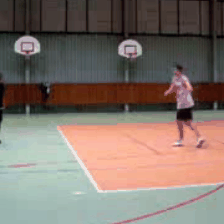

In [ ]:
import imageio
import numpy as np
from IPython.display import Image

def unnormalize_img(img):
    """Un-normalizes the image pixels."""
    img = (img * std) + mean
    img = (img * 255).astype("uint8")
    return img.clip(0, 255)

def create_gif(video_tensor, filename="sample.gif"):
    """Prepares a GIF from a video tensor.
    The video tensor is expected to have the following shape:
    (num_frames, num_channels, height, width).
    """
    frames = []
    for video_frame in video_tensor:
        frame_unnormalized = unnormalize_img(video_frame.permute(1, 2, 0).numpy())
        frames.append(frame_unnormalized)
    kargs = {"duration": 0.25}
    imageio.mimsave(filename, frames, "GIF", **kargs)
    return filename

def display_gif(video_tensor, gif_name="sample.gif"):
    """Prepares and displays a GIF from a video tensor."""
    video_tensor = video_tensor.permute(1, 0, 2, 3)
    gif_filename = create_gif(video_tensor, gif_name)
    return Image(filename=gif_filename)

sample_video = next(iter(train_dataset))
video_tensor = sample_video["video"]
display_gif(video_tensor)

In [ ]:
from transformers import TrainingArguments, Trainer

model_name = model_ckpt.split("/")[-1]
new_model_name = f"{model_name}-finetuned-ucf101-subset"
num_epochs = 4
batch_size = 8
args = TrainingArguments(
    new_model_name,
    remove_unused_columns=False,
    eval_strategy="epoch",
    save_strategy="epoch",
    learning_rate=5e-5,
    per_device_train_batch_size=batch_size,
    per_device_eval_batch_size=batch_size,
    warmup_ratio=0.1,
    logging_steps=10,
    load_best_model_at_end=True,
    metric_for_best_model="accuracy",
    push_to_hub=False,
    max_steps=(train_dataset.num_videos // batch_size) * num_epochs,
)

In [ ]:
import evaluate

metric = evaluate.load("accuracy")


def compute_metrics(eval_pred):
    predictions = np.argmax(eval_pred.predictions, axis=1)
    return metric.compute(predictions=predictions, references=eval_pred.label_ids)

In [ ]:
def collate_fn(examples):
    # permute to (num_frames, num_channels, height, width)
    pixel_values = torch.stack(
        [example["video"].permute(1, 0, 2, 3) for example in examples]
    )
    labels = torch.tensor([example["label"] for example in examples])
    return {"pixel_values": pixel_values, "labels": labels}

In [ ]:
trainer = Trainer(
    model,
    args,
    train_dataset=train_dataset,
    eval_dataset=val_dataset,
    tokenizer=image_processor,
    compute_metrics=compute_metrics,
    data_collator=collate_fn,
)

max_steps is given, it will override any value given in num_train_epochs


In [ ]:
import torch
train_results = trainer.train()

Epoch,Training Loss,Validation Loss


Error: You must call wandb.init() before wandb.log()

# 2. 예비학습


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import imageio
import IPython.display

## A. 이미지자료의 이해


`-` `plt.imshow(...)` 에서 `...` 자리에 오는 numpy array의 shape이 (??,??) 와 같이 2차원 꼴이면 흑백이미지를 출력

In [ ]:
np.array([[0,150],[0,255]])

array([[  0, 150],
       [  0, 255]])

In [ ]:
np.array([[0,150],[0,255]]).shape

(2, 2)

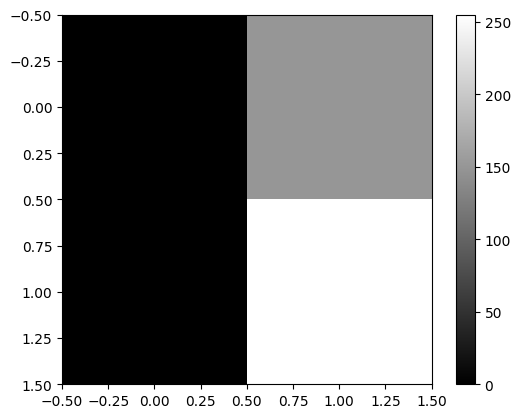

In [ ]:
plt.imshow(np.array([[0,150],[0,255]]),cmap='gray')
plt.colorbar()

`-` `plt.imshow(...)` 에서 `...` 자리에 오는 numpy array의 shape이 (??,??,3) 이러한 형태이면 칼라이미지를 출력

In [ ]:
R = np.array([[0,255],
              [0,255]])
G = np.array([[255,0],
              [0,  0]])
B = np.array([[0,  0],
              [255,0]])

In [ ]:
np.stack([R,G,B],axis=-1).shape # 형태

(2, 2, 3)

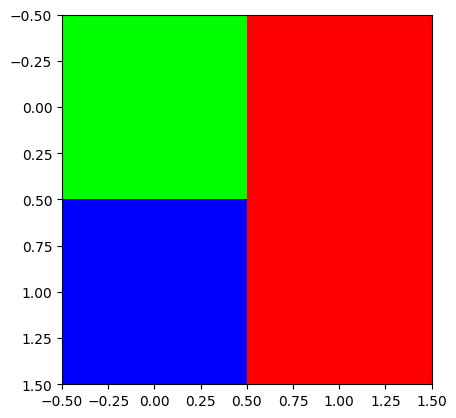

In [ ]:
plt.imshow(np.stack([R,G,B],axis=-1))

In [ ]:
R.dtype # int 이런식이면 갠차는데.... plot일때는 쫌 다르다능

dtype('int64')

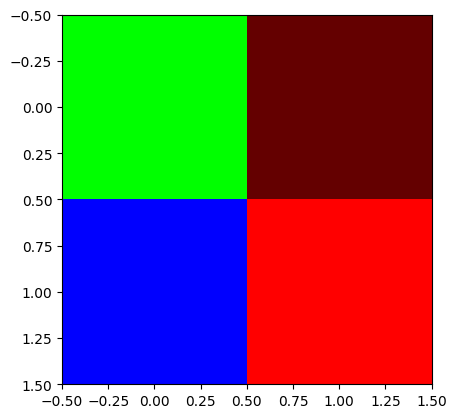

In [ ]:
R = np.array([[0,100], # 225 -> 100 빨간빛이 줄어듦 -> 숫자가 색깔??을 의미한다고 생각
              [0,255]])
G = np.array([[255,0],
              [0,  0]])
B = np.array([[0,  0],
              [255,0]])
plt.imshow(np.stack([R,G,B],axis=-1))

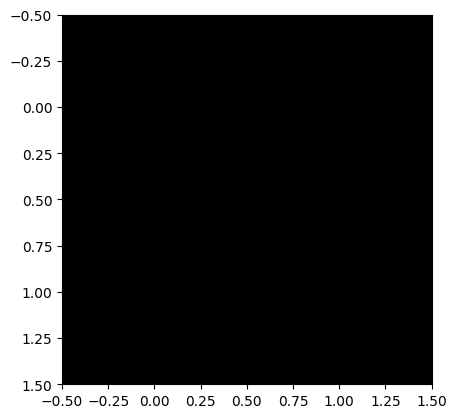

In [ ]:
R = np.array([[0,1], # 1로 바꾸니까 검정색됨요
              [0,1]])
G = np.array([[1,0],
              [0,  0]])
B = np.array([[0,  0],
              [1,0]])
plt.imshow(np.stack([R,G,B],axis=-1))

In [ ]:
np.stack([R,G,B],axis=-1).dtype # int형임

dtype('int64')

In [ ]:
np.stack([R,G,B],axis=-1).astype(float) # float 타입으로 바꿔줍니

array([[[0., 1., 0.],
        [1., 0., 0.]],

       [[0., 0., 1.],
        [1., 0., 0.]]])

`-` `plt.imshow(...)`는 `...`자리에 오는 numpy array의 dtype의 int인지 float인지에 따라서 시각화 결과가 다름.

- int일 경우: 0을 최소값, 255를 최대값으로 생각하고 그림을 그려줌
- float일 경우: 0.0을 최소값, 1.0을 최대값으로 생각하고 그림을 그려줌.

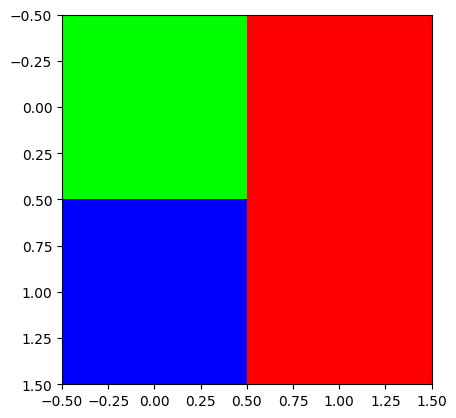

In [ ]:
R = np.array([[0,1],
              [0,1]])
G = np.array([[1,0],
              [0,0]])
B = np.array([[0,0],
              [1,0]])
# plt.imshow(np.stack([R,G,B],axis=-1))
plt.imshow(np.stack([R,G,B],axis=-1).astype(float))

## B. `tsr.permute()`

-> 요고 잘 기억하라고 하심

`-` 실수로 R,G,B를 이상한 방식으로 stack 했다고 가정하자.

In [ ]:
R = np.array([[0,255],[0,255]])
G = np.array([[255,0],[0,0]])
B = np.array([[0,0],[255,0]])
# img = np.stack([R,G,B],axis=-1) <-- 원래는 이걸 하려고 했었음..
img = np.stack([R,G,B],axis=0) # (3,2,2) <-- 실수로 이케 만들어버림
img.shape

(3, 2, 2)

`-` 차원이 맞지 않아서 `plt.imshow(img)`이 동작하지 않음

--> 동작하기 위해서는 `plt.imshow(...)` 에서 `...` 자리에 있는 numpy array가 HCW 와 같은 형식으로 되어야 함. (그런데 지금은 CHW 형식)

TypeError: Invalid shape (3, 2, 2) for image data

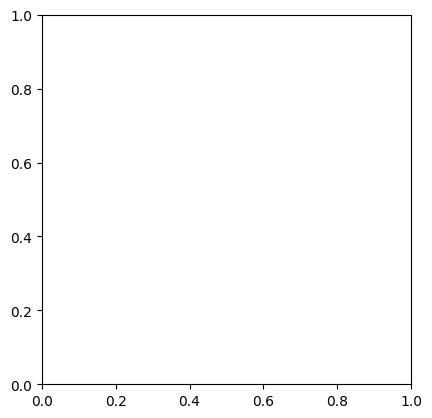

In [ ]:
plt.imshow(img)

`-` 에러를 피하기 위해서는 차원을 `(3,2,2)`에서 `(2,2,3)`으로 바꾸어야함.

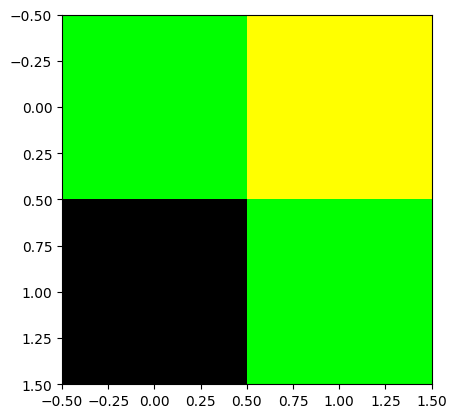

In [ ]:
plt.imshow(img.reshape(2,2,3)) # 뭔 이상한 그림이 나오노

- 우리가 원하는 그림은 이게 아님..
- 왜 이렇지???

`-` 이미지자료의 차원을 바꾸고 싶으면 `reshape`을 쓰지말고 `np.transpose`를 이용하3


In [ ]:
img.shape

(3, 2, 2)

(3,2,2) --> (2,2,3)

(0,1,2) --> (1,2,0)

In [ ]:
img.reshape(2,2,3), np.transpose(img,(1,2,0))

(array([[[  0, 255,   0],
         [255, 255,   0]],
 
        [[  0,   0,   0],
         [  0, 255,   0]]]),
 array([[[  0, 255,   0],
         [255,   0,   0]],
 
        [[  0,   0, 255],
         [255,   0,   0]]]))

- 위의 두 개의 array는 차원이 같음 $\to$ 그림 자체는 둘 다 그려짐
- 그렇지만, 같은 array는 아님 $\to$ 당연히 그림도 달라짐

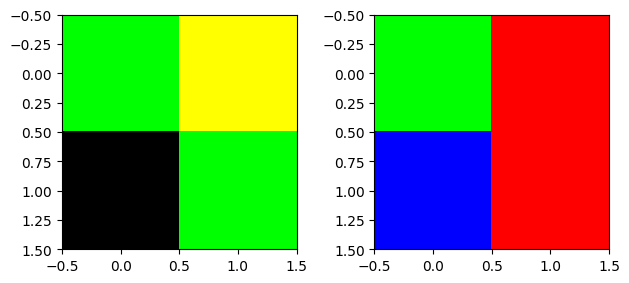

In [ ]:
fig, ax = plt.subplots(1,2) # 그림 나란히 그리는 코드

ax[0].imshow(img.reshape(2,2,3)) # 왼쪽
ax[1].imshow(np.transpose(img,(1,2,0))) # 오른쪽
fig.tight_layout()

`-` 왼쪽은 이상한 조합,

In [ ]:
arr =np.random.rand(25,30,3)
arr.shape

(25, 30, 3)

(25,30,3) --> (30,25,3)

(0,1,2) --> (1,0,2)

In [ ]:
np.transpose(arr,(1,0,2)).shape

(30, 25, 3)

`-` numpy array가 아니고, pytorch tensor 일 경우에는, 아래의 방법으로 변환

In [ ]:
arr = np.random.rand(2,4,3)
tsr = torch.tensor(arr)

In [ ]:
np.transpose(arr,(2,0,1)).shape # (2,4,3) --> (3,2,4)

(3, 2, 4)

In [ ]:
tsr.permute(2,0,1) # (2,4,3) --> (3,2,4)
# np.transpose(arr,(2,0,1)).shape # 같은 코

tensor([[[0.2247, 0.5480, 0.5156, 0.9535],
         [0.1913, 0.8369, 0.5433, 0.7250]],

        [[0.2559, 0.5157, 0.3642, 0.4616],
         [0.6123, 0.4865, 0.2699, 0.2976]],

        [[0.6773, 0.9476, 0.3629, 0.6875],
         [0.0967, 0.2209, 0.9592, 0.1083]]], dtype=torch.float64)

## C. 영상 자료 이해

`-` 영상자료 = 여러사진들의 모음 = [사진1, 사진2, 사진3, 사진4, ….]

In [ ]:
np.random.seed(43052)
v = (np.random.rand(4,60,60,3)*255).astype('uint8') # 4개의 사진, 사진 사이즈 60*60, 채널=3 -> 컬러)
v[0,:,:,0] = 255 # 첫번째 프레임의 R채널을 모두 최대치로 설정
v[1,:,:,1] = 255 # 두번째 프레임의 G채널을 모두 최대치로 설정
v[2,:,:,2] = 255 # 첫번째 프레임의 B채널을 모두 최대치로 설정

--> 그냥 int 써도되지만 쓰는 숫자가 우린 적으므로 조금 더 적은?? 범위에 쓰는 uint8을 써줌

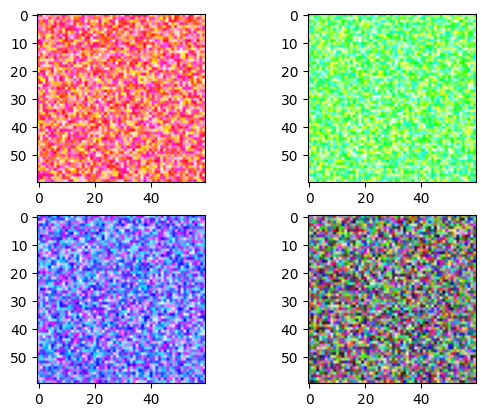

In [ ]:
fig, ax = plt.subplots(2,2)
#ax[0][0].imshow(v[0,:,:,:])
#ax[0][1].imshow(v[1,:,:,:])
#ax[1][0].imshow(v[2,:,:,:])
#ax[1][1].imshow(v[3,:,:,:])
ax[0][0].imshow(v[0])
ax[0][1].imshow(v[1])
ax[1][0].imshow(v[2])
ax[1][1].imshow(v[3])

In [ ]:
frames = [frame for frame in v]
# frames = [사진1, 사진2, 사진3, 사진4]

In [ ]:
imageio.mimsave('sample.gif',frames)

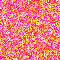

In [ ]:
IPython.display.Image('sample.gif')

## D. `arr.clip()`

In [ ]:
arr = np.array([[300,-20,150], [400,100,0],[255,500,-100]])
arr

array([[ 300,  -20,  150],
       [ 400,  100,    0],
       [ 255,  500, -100]])

In [ ]:
np.clip(arr,0,255)

array([[255,   0, 150],
       [255, 100,   0],
       [255, 255,   0]])

- 0보다 작은 애들 -> 0
- 255보다 큰 애들 -> 255

# 3. 살펴보기

`-` 처음에는 `/root/cache` 에 `huggingface` 라는 폴더가 존재하지 않음

In [ ]:
import huggingface_hub

## A. 다운로드


In [ ]:
file_path = huggingface_hub.hf_hub_download(
    repo_id="sayakpaul/ucf101-subset",
    filename="UCF101_subset.tar.gz", # 얘를 다운로
    repo_type="dataset"
)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [ ]:
file_path

'/root/.cache/huggingface/hub/datasets--sayakpaul--ucf101-subset/snapshots/b9984b8d2a95e4a1879e1b071e9433858d0bc24a/UCF101_subset.tar.gz'

`-` 위의 명령어를 실행하면 `/root/.cache` 에 적당한 폴더가 만들어지고 `UCF101_subset.tar.gz` 와 같은 파일이 다운로드 되어있음

`-` `huggingface_hub.hf_hub_download` 함수의 역할:

(1) `UCF101_subset.tar.gz` 파일을 다운로드

(2) 다운로드한 압축파일의 경로를 `str` 으로 리턴

## B. 압축풀기

`-` imports

In [ ]:
import tarfile

`-` 아래의 코드는 현재폴더에 `UCF101_subset.tar.gz` 파일의 압축을 해제하는 코드이다.

In [ ]:
# file_path는 다운로드한 압축파일이 존재하는 경로와 파일명이 string으로 저장되어있음.
with tarfile.open(file_path) as t:
     t.extractall(".") # 여기에서 "."은 현재폴더라는 의미

--> 즉, 현재폴더에 압출을 풀라는 말!!

`-` `tarfile.TarFile` 의 인스턴스 `t` 가 가지는 주요기능

In [ ]:
t = tarfile.open(file_path)
t.extractall("./asdf")

In [ ]:
type(t)

tarfile.TarFile

`-` `tarfile.TarFile` 의 인스턴스 `t` 가 가지는 덜 중요한 기능: 더이상 압축을 풀고 싶지 않을때,`t,close()`를 이용하여 `t.extractall`을 봉인할 수 있다.

In [ ]:
t = tarfile.open(file_path) # t 오브젝트 생성
t.closed # 오브젝트 생성 직후에는 t.closed는 Flase

False

In [ ]:
t.extractall("./여기에")

In [ ]:
t.extractall("./저기에")

In [ ]:
t.close() # 더이상 무분별하게 압축을 풀고싶지 않다면 이걸 실행

In [ ]:
t.closed # 그렇다면 True가 되고

True

In [ ]:
t.extractall('./또풀어') # 에러발생

OSError: TarFile is closed

`-` `tarfile.TarFile` 의 인스턴스 `t` 가 가지는 덜 주요기능 2: `t._check()` 은 t.closed = Ture 일 때 실행하면 에러를 발생시키는 역할을

In [ ]:
print(t.closed)
t._check() # t.closed 가 open 일 경우에는 에러 X

False


In [ ]:
t.close()
print(t.closed)
t._check() # t.closed 가 open 일 경우에는 에러 X

True


OSError: TarFile is closed

`-` with의 이해

아래와 같은 코드를 작성하고 싶음


```
1. `t`를 만듦. 즉 `TarFile`의 인스턴스를 만듦.
2. `t`가 열린상태인지 체크 (=압축풀기가 가능한 상태인지 체크를 해줌, 닫힌상태라면 에러메시지 발생하고 진행중지)
3. 압축해제
4. `t`를 닫힌상태로 만듦.
```

In [ ]:
t = tarfile.open(file_path)
t._check()
t.extractall('.')
t.close()

*위의 코드는 아래의 코드와 같은 효과

In [ ]:
with tarfile.open(file_path) as t:
  ## 시작코드 -- t.check() 이 자동실행 (사실은 t.__enter__()이 실행)
  t.extractall('.') ## 본코드
  ## 마무리코드 -- t.close() 이 자동실행 (사실은 t.__exit__()이 실행)

In [ ]:
t.closed # 예쁘게 잘 닫혀있음..

True

In [ ]:
t.__enter__??

In [ ]:
t.__exit__??

- 구냥 있자나..? with문 실행하면 자동으로 저거 된다구 생각해

## C. 영상확인

`-` 코덱문제로 인하여 `v_Basketball_g01_c01.avi` 는 재생이 안됨

In [ ]:
!ffmpeg -i UCF101_subset/train/Basketball/v_Basketball_g01_c01.avi -vcodec libx264 -acodec aac output_video.mp4 -y

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

`-` `output_video.mp4` 를 다운로드하고 재생

## D. 영상 불러오기

`-` imports

In [ ]:
import pytorchvideo.data
import os
import pathlib

### `#` 영상(avi) $\to$ 텐서

In [ ]:
dataset_root_path = "UCF101_subset"
dataset_root_path = pathlib.Path(dataset_root_path)
os.path.join(dataset_root_path, "train") # data_path 에 넣읍시당

'UCF101_subset/train'

In [ ]:
_train_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("random", 10),
    decode_audio = False,
#    transform = train_transform,
)

In [ ]:
video_cthw = next(_train_dataset)['video'] # 현재 위치에서 비디오 데이터를 가져온 다음, 위치를 다음으로 이동시
video_cthw.shape

torch.Size([3, 141, 240, 320])

### `#` 텐서 $\to$ 영상

`-` 차원변환

In [ ]:
video_thwc = video_cthw.permute(1,2,3,0)
video_thwc.shape

torch.Size([141, 240, 320, 3])

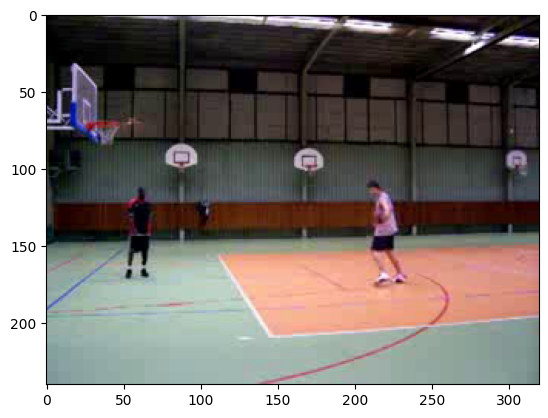

In [ ]:
plt.imshow(video_thwc[0].numpy().astype('uint8')) # 사진이 나타남 (숫자 바꾸면 다르게 나타남)

`-` gif 만들기

In [ ]:
frames = [frame.numpy().astype('uint8') for frame in video_thwc]
imageio.mimsave('sample.gif',frames)

NameError: name 'video_thwc' is not defined

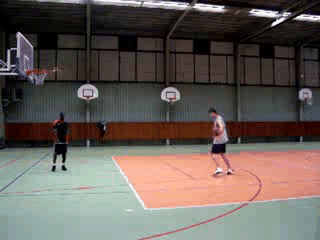

In [ ]:
IPython.display.Image('sample.gif')

`-` "텐서 $\to$  영상" 이 되는 함수를 선언하자.

In [ ]:
def _display_gif(video_cthw):
  video_thwc = video_cthw.permute(1,2,3,0)
  frames = [frame.numpy().astype('uint8') for frame in video_thwc]
  imageio.mimsave('sample.gif',frames)
  return IPython.display.Image('sample.gif')

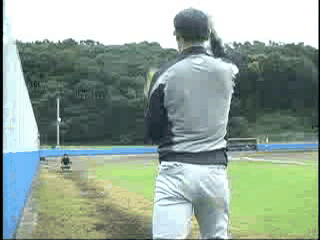

In [ ]:
_display_gif(next(_train_dataset)['video'])

`-` `pytorchvideo.data.make_clip_sampler("random", 10)` 의 의미를 알아보자

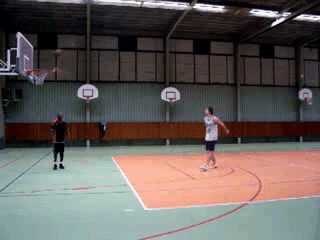

In [ ]:
_train_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("random", 0.5),
    decode_audio = False,
#    transform = train_transform,
)
_display_gif(next(_train_dataset)['video'])

- 랜덤으로 영상이 짤려서 나옴
- 숫자가 작아질수록 초수가 줄어듦

`-` `pytorchvideo.data.make_clip_sampler("uniform", 10)` 의 의미를 알아보자

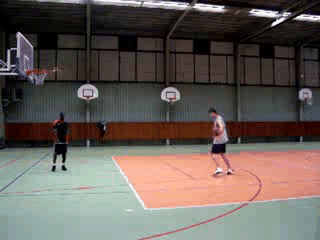

In [ ]:
_train_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("uniform", 0.5),
    decode_audio = False,
#    transform = train_transform,
)
_display_gif(next(_train_dataset)['video'])

- 아무리 코드 돌려도 동일한 결과가 나옴
- 고정된 값!!
- 여전히 숫자 줄이면 초수는 줄어듦

## E. 모델생성


`-` import

In [ ]:
import transformers

`-` 모델생성

In [ ]:
list(dataset_root_path.glob("train/*/*.avi")) # 파일 'UCF101_subset'에서 train에 있는 모든 폴더, 모든 파일에서 .avi로 끝나는 애들의 리스트를 불러오라는 말
list(dataset_root_path.glob("val/*/*.avi")) # 파일 'UCF101_subset'에서 val에 있는 모든 폴더, 모든 파일에서 .avi로 끝나는 애들의 리스트를 불러오라는 말
list(dataset_root_path.glob("test/*/*.avi")) # 파일 'UCF101_subset'에서 test에 있는 모든 폴더, 모든 파일에서 .avi로 끝나는 애들의 리스트를 불러오라는 말

In [ ]:
dataset_root_path = "UCF101_subset" # 파일 'UCF101_subset' 지정
dataset_root_path = pathlib.Path(dataset_root_path)
all_video_file_paths = (
    list(dataset_root_path.glob("train/*/*.avi"))
    + list(dataset_root_path.glob("val/*/*.avi"))
    + list(dataset_root_path.glob("test/*/*.avi"))
 )
all_video_file_paths[:5]
class_labels = sorted({str(path).split("/")[2] for path in all_video_file_paths})
label2id = {label: i for i, label in enumerate(class_labels)}
id2label = {i: label for label, i in label2id.items()}

# 위의 코드를 활용해서 라벨을 밑에 직접 만들어줬음

In [ ]:
label2id = {'ApplyEyeMakeup': 0,
            'ApplyLipstick': 1,
            'Archery': 2,
            'BabyCrawling': 3,
            'BalanceBeam': 4,
            'BandMarching': 5,
            'BaseballPitch': 6,
            'Basketball': 7,
            'BasketballDunk': 8,
            'BenchPress': 9}

In [ ]:
id2label = {0: 'ApplyEyeMakeup',
            1: 'ApplyLipstick',
            2: 'Archery',
            3: 'BabyCrawling',
            4: 'BalanceBeam',
            5: 'BandMarching',
            6: 'BaseballPitch',
            7: 'Basketball',
            8: 'BasketballDunk',
            9: 'BenchPress'}

In [ ]:
model =transformers.VideoMAEForVideoClassification.from_pretrained(
    "MCG-NJU/videomae-base",
    label2id=label2id,
    id2label=id2label,
    ignore_mismatched_sizes=True,  # provide this in case you're planning to fine-tune an already fine-tuned checkpoint
)

Some weights of VideoMAEForVideoClassification were not initialized from the model checkpoint at MCG-NJU/videomae-base and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


## F. 변환 $\to$ tr/val/test 생성

`-` import

In [ ]:
import pytorchvideo.transforms
import torchvision.transforms

####(1) pytorchvideo.transforms.UniformTemporalSubsample(16)

 - 프레임의 두 번 째 숫자(프레임 수)는 실행 할 때마다 항상 바뀜..
 - 얘를 사용함으로써 프레임 수를 16으로 항상 고정시켜줌

In [ ]:
model.config.num_frames

16

In [ ]:
model.classifier.weight # 이 숫자들이 이미 어느정도 맞추어진 숫자들인데..
# 이 숫자들을 어느정도 맞출때 사용된 영상의 프레임수가 16임...

Parameter containing:
tensor([[-0.0192,  0.0165,  0.0031,  ..., -0.0334, -0.0200,  0.0028],
        [ 0.0315,  0.0251, -0.0167,  ..., -0.0061,  0.0210,  0.0173],
        [-0.0018,  0.0115, -0.0054,  ...,  0.0121, -0.0143,  0.0133],
        ...,
        [-0.0173, -0.0045, -0.0116,  ..., -0.0028, -0.0208,  0.0028],
        [-0.0144,  0.0159, -0.0075,  ..., -0.0051,  0.0169,  0.0362],
        [-0.0011,  0.0354, -0.0166,  ...,  0.0449,  0.0049,  0.0124]],
       requires_grad=True)

In [ ]:
_train_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("random", 10),
    decode_audio = False,
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video", # key를 video로 설정하여 video에만 적용해줌
            transform=Compose(
                [
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    #torchvision.transforms.Lambda(lambda x: x / 255.0),
                    #pytorchvideo.transforms.Normalize(mean, std),
                    #pytorchvideo.transforms.RandomShortSideScale(min_size=256, max_size=320),
                    #torchvision.transforms.RandomCrop(resize_to),
                    #torchvision.transforms.RandomHorizontalFlip(p=0.5),
                ]
            ),
        )
)

In [ ]:
next(_train_dataset)['video'].shape
# 원래 실행할때마다 두 번째값이 다르게 나오는데... UniformTemporalSubsample 얘가 특정 값(16)으로 고정시켜줌

torch.Size([3, 16, 240, 320])

#### (2) torchvision.transforms.Lambda(lambda x: x / 255.0)
  - v에 있는 모든 값을 255로 나누어줌

In [ ]:
_train_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("random", 10),
    decode_audio = False,
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video", # key를 video로 설정하여 video에만 적용해줌
            transform=Compose(
                [
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    torchvision.transforms.Lambda(lambda x: x / 255.0),
                    #pytorchvideo.transforms.Normalize(mean, std),
                    #pytorchvideo.transforms.RandomShortSideScale(min_size=256, max_size=320),
                    #torchvision.transforms.RandomCrop(resize_to),
                    #torchvision.transforms.RandomHorizontalFlip(p=0.5),
                ]
            ),
        )
)

In [ ]:
v = next(_train_dataset)['video']

In [ ]:
v

tensor([[[[0.0431, 0.0471, 0.0510,  ..., 0.0784, 0.0706, 0.0549],
          [0.0196, 0.0235, 0.0314,  ..., 0.0784, 0.1098, 0.1373],
          [0.0078, 0.0078, 0.0157,  ..., 0.1137, 0.1059, 0.1020],
          ...,
          [0.5020, 0.5020, 0.5020,  ..., 0.4392, 0.4314, 0.4275],
          [0.5020, 0.5020, 0.5020,  ..., 0.4392, 0.4314, 0.4275],
          [0.5020, 0.5020, 0.5020,  ..., 0.4392, 0.4314, 0.4275]],

         [[0.0314, 0.0353, 0.0392,  ..., 0.0902, 0.0745, 0.0549],
          [0.0118, 0.0157, 0.0235,  ..., 0.0863, 0.1098, 0.1333],
          [0.0078, 0.0078, 0.0157,  ..., 0.1098, 0.1020, 0.0902],
          ...,
          [0.4980, 0.4941, 0.4980,  ..., 0.4275, 0.4235, 0.4196],
          [0.4980, 0.4941, 0.4980,  ..., 0.4275, 0.4235, 0.4196],
          [0.4980, 0.4941, 0.4980,  ..., 0.4275, 0.4235, 0.4196]],

         [[0.0392, 0.0392, 0.0510,  ..., 0.0980, 0.0824, 0.0627],
          [0.0235, 0.0275, 0.0314,  ..., 0.0863, 0.1020, 0.1176],
          [0.0039, 0.0039, 0.0118,  ..., 0

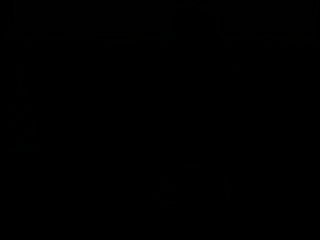

In [ ]:
_display_gif(next(_train_dataset)['video'])

-> 까맣게 나온당....

-> 0~255의 값을 가졌었는데

-> 0~1사이의 값을 가지게 되면서 이렇게 되어버림

#### (3) mean, std, resize_to
- 각 채널별로 표준화해줌

In [ ]:
image_processor = transformers.VideoMAEImageProcessor.from_pretrained("MCG-NJU/videomae-base")
mean = image_processor.image_mean
std = image_processor.image_std

preprocessor_config.json:   0%|          | 0.00/271 [00:00<?, ?B/s]

In [ ]:
mean, std

([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])

In [ ]:
_train_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("random", 10),
    decode_audio = False,
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video", # key를 video로 설정하여 video에만 적용해줌
            transform=Compose(
                [
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    torchvision.transforms.Lambda(lambda x: x / 255.0),
                    pytorchvideo.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
                    #pytorchvideo.transforms.RandomShortSideScale(min_size=256, max_size=320),
                    #torchvision.transforms.RandomCrop(resize_to),
                    #torchvision.transforms.RandomHorizontalFlip(p=0.5),
                ]
            ),
        )
)

In [ ]:
next(_train_dataset)['video'] # 각 채널별로 표준띠(변환)해줌

tensor([[[[-1.9295, -1.9124, -1.8953,  ..., -1.7754, -1.8097, -1.8782],
          [-2.0323, -2.0152, -1.9809,  ..., -1.7754, -1.6384, -1.5185],
          [-2.0837, -2.0837, -2.0494,  ..., -1.6213, -1.6555, -1.6727],
          ...,
          [ 0.0741,  0.0741,  0.0741,  ..., -0.1999, -0.2342, -0.2513],
          [ 0.0741,  0.0741,  0.0741,  ..., -0.1999, -0.2342, -0.2513],
          [ 0.0741,  0.0741,  0.0741,  ..., -0.1999, -0.2342, -0.2513]],

         [[-1.9809, -1.9638, -1.9467,  ..., -1.7240, -1.7925, -1.8782],
          [-2.0665, -2.0494, -2.0152,  ..., -1.7412, -1.6384, -1.5357],
          [-2.0837, -2.0837, -2.0494,  ..., -1.6384, -1.6727, -1.7240],
          ...,
          [ 0.0569,  0.0398,  0.0569,  ..., -0.2513, -0.2684, -0.2856],
          [ 0.0569,  0.0398,  0.0569,  ..., -0.2513, -0.2684, -0.2856],
          [ 0.0569,  0.0398,  0.0569,  ..., -0.2513, -0.2684, -0.2856]],

         [[-1.9467, -1.9467, -1.8953,  ..., -1.6898, -1.7583, -1.8439],
          [-2.0152, -1.9980, -

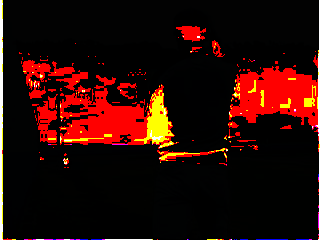

In [ ]:
_display_gif(next(_train_dataset)['video']) # 그림 존나 기괴하

In [ ]:
_display_gif??

- 변환된 이미지 텐서...
- 이미지가 존나 깨지고 엉망진창와진창임
- 원상복구 ㄱ

In [ ]:
def display_gif(video_cthw):
  mean = [0.485, 0.456, 0.406]
  std = [0.229, 0.224, 0.225]
  #--#
  video_thwc = video_cthw.permute(1,2,3,0)
  frames = []
  for frame in video_thwc:
    img = frame = frame.numpy()
    img = (img * std) + mean
    img = (img * 255).astype('uint8')
    img = img.clip(0,255)
    frames.append(img)
  imageio.mimsave('sample.gif',frames, duration=0.25)
  return IPython.display.Image('sample.gif')

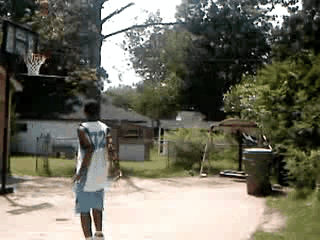

In [ ]:
display_gif(next(_train_dataset)['video'])

#### (4) pytorchvideo.transforms.RandomShortSideScale(min_size=256, max_size=320)

- 사진의 사이즈를 256~320 사이에서 랜덤한 값으로 조정해줌

torch.Size([3, 16, 293, 390])


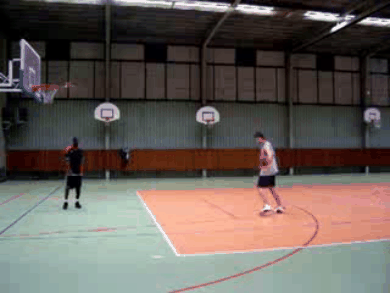

In [ ]:
_train_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("random", 10),
    decode_audio = False,
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video", # key를 video로 설정하여 video에만 적용해줌
            transform=Compose(
                [
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    torchvision.transforms.Lambda(lambda x: x / 255.0),
                    pytorchvideo.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
                    pytorchvideo.transforms.RandomShortSideScale(min_size=256, max_size=320),
                    #torchvision.transforms.RandomCrop(resize_to),
                    #torchvision.transforms.RandomHorizontalFlip(p=0.5),
                ]
            ),
        )
)
v = next(_train_dataset)['video']
print(v.shape)
display_gif(v)

#### (5) torchvision.transforms.RandomCrop(resize_to)
- 사진의 크기를 224*224 로 랜덤으로 잘라줌 (어느 부분에서 어떻게 잘릴지는 모름)

In [ ]:
if "shortest_edge" in image_processor.size:
    height = width = image_processor.size["shortest_edge"]
else:
    height = image_processor.size["height"]
    width = image_processor.size["width"]
resize_to = (height, width)
resize_to

(224, 224)

torch.Size([3, 16, 224, 224])


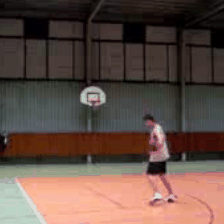

In [ ]:
_train_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("random", 10),
    decode_audio = False,
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video", # key를 video로 설정하여 video에만 적용해줌
            transform=Compose(
                [
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    torchvision.transforms.Lambda(lambda x: x / 255.0),
                    pytorchvideo.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
                    pytorchvideo.transforms.RandomShortSideScale(min_size=256, max_size=320),
                    torchvision.transforms.RandomCrop((224, 224)),
                    #torchvision.transforms.RandomHorizontalFlip(p=0.5),
                ]
            ),
        )
)
v = next(_train_dataset)['video']
print(v.shape)
display_gif(v)

#### (6) torchvision.transforms.RandomHorizontalFlip(p=0.5)

- 좌우반전 랜덤으로 해줌

torch.Size([3, 16, 224, 224])


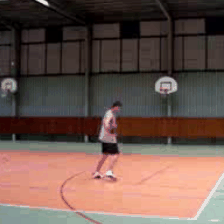

In [ ]:
_train_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("random", 10),
    decode_audio = False,
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video", # key를 video로 설정하여 video에만 적용해줌
            transform=Compose(
                [
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    torchvision.transforms.Lambda(lambda x: x / 255.0),
                    pytorchvideo.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
                    pytorchvideo.transforms.RandomShortSideScale(min_size=256, max_size=320),
                    torchvision.transforms.RandomCrop((224, 224)),
                    torchvision.transforms.RandomHorizontalFlip(p=0.5),
                ]
            ),
        )
)
v = next(_train_dataset)['video']
print(v.shape)
display_gif(v)

### `총정리`

`-` 이미지전처리에 도움이 되는 `image_processor`를 불러오는 코드

In [ ]:
image_processor = transformers.VideoMAEImageProcessor.from_pretrained("MCG-NJU/videomae-base")

`-` 저장된 값들


In [ ]:
print(
    f"mean: {image_processor.image_mean}\n"
    f"std: {image_processor.image_std}\n"
    f"size: {image_processor.size}\n"
    f"resize_to: {(224,224)}\n"
    f"num_frames_to_sample: {model.config.num_frames}\n"
    f"clip_duration: {2.1333333333333333}"
)

mean: [0.485, 0.456, 0.406]
std: [0.229, 0.224, 0.225]
size: {'shortest_edge': 224}
resize_to: (224, 224)
num_frames_to_sample: 16
clip_duration: 2.1333333333333333


- 모델 `MCG-NJU/videomae-base` 의 성능을 최고로 이끌어 내기 위해서는 어떠한 최적화된 변환이 있음
- 위에 제시된 값들은 그 최적화된 변환을 구현하기위해 필요한 값들임.

`-` 변환된 이미지텐서를 올바르게 출력하기 위해 `_display_gif` 를 수정하여 `display_gif` 를 만듦.

In [ ]:
def display_gif(video_cthw):
  mean = [0.485, 0.456, 0.406]
  std = [0.229, 0.224, 0.225]
  #--#
  video_thwc = video_cthw.permute(1,2,3,0)
  frames = []
  for frame in video_thwc:
    img = frame = frame.numpy()
    img = (img * std) + mean
    img = (img * 255).astype('uint8')
    img = img.clip(0,255)
    frames.append(img)
  imageio.mimsave('sample.gif',frames, duration=0.25)
  return IPython.display.Image('sample.gif')

`-` 최적화된 변환을 적용하여 `train_dataset` 을 불러옴.

In [ ]:
train_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("random", 2.1333333333333333),
    decode_audio = False,
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video", # key를 video로 설정하여 video에만 적용해줌
            transform=Compose(
                [
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    torchvision.transforms.Lambda(lambda x: x / 255.0),
                    pytorchvideo.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
                    pytorchvideo.transforms.RandomShortSideScale(min_size=256, max_size=320),
                    torchvision.transforms.RandomCrop((224, 224)),
                    torchvision.transforms.RandomHorizontalFlip(p=0.5),
                ]
            ),
        )
)

`-` 이제 `val_dataset`, `test_dataset` 도 불러옴

In [ ]:
val_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("uniform", 2.1333333333333333),
    decode_audio = False, # 음성 x
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video", # key를 video로 설정하여 video에만 적용해줌
            transform=Compose(
                [
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    torchvision.transforms.Lambda(lambda x: x / 255.0),
                    pytorchvideo.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
                    torchvision.transforms.Resize((224,224)) # 비율에 맞게 이미지를 조정해줌. 버리는 이미지 x
                ]
            ),
        )
)
test_dataset = pytorchvideo.data.Ucf101(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("uniform", 2.1333333333333333),
    decode_audio = False, # 음성 x
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video", # key를 video로 설정하여 video에만 적용해줌
            transform=Compose(
                [
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    torchvision.transforms.Lambda(lambda x: x / 255.0),
                    pytorchvideo.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
                    torchvision.transforms.Resize((224,224)) # 비율에 맞게 이미지를 조정해줌. 버리는 이미지 x
                ]
            ),
        )
)

-> 학습(train) 할 때는 random하게 해서 학습을 더 잘하기 위함..

-> test 할 때에는 굳이 random 안해도됨

## G. 데이터콜렉터

`-` 일단은 아래가 실행되지 않음을 관찰하자.

In [ ]:
model(train_dataset)

AttributeError: 'LabeledVideoDataset' object has no attribute 'shape'

`-` 실행되는 형태1: model(tsr_ntchw)

In [ ]:
examples = [next(train_dataset), next(train_dataset)]

`-` 실행예시 1

In [ ]:
model(examples[0]['video'].permute(1,0,2,3).reshape(1,16,3,224,224))

ImageClassifierOutput(loss=None, logits=tensor([[ 0.1021,  0.0632,  0.0558,  0.3480, -0.0057, -0.6766, -0.1697,  0.0102,
          0.5333, -0.4472]], grad_fn=<AddmmBackward0>), hidden_states=None, attentions=None)

`-` 실행예시 2

In [ ]:
model(torch.stack([examples[0]['video'].permute(1,0,2,3),examples[1]['video'].permute(1,0,2,3)],axis=0))

ImageClassifierOutput(loss=None, logits=tensor([[ 0.1021,  0.0632,  0.0558,  0.3480, -0.0057, -0.6766, -0.1697,  0.0102,
          0.5333, -0.4472],
        [ 0.4166,  1.0568, -0.1751,  0.2291, -0.1805, -0.5583, -0.1360,  0.2029,
          0.0418, -0.4219]], grad_fn=<AddmmBackward0>), hidden_states=None, attentions=None)

`-` 실행예시 3

In [ ]:
model(torch.stack([example['video'].permute(1,0,2,3) for example in examples],axis = 0))

ImageClassifierOutput(loss=None, logits=tensor([[ 0.1021,  0.0632,  0.0558,  0.3480, -0.0057, -0.6766, -0.1697,  0.0102,
          0.5333, -0.4472],
        [ 0.4166,  1.0568, -0.1751,  0.2291, -0.1805, -0.5583, -0.1360,  0.2029,
          0.0418, -0.4219]], grad_fn=<AddmmBackward0>), hidden_states=None, attentions=None)

`-` 실행되는 형태1: `model(**{"pixel_values":tsr_ntchw, "labels":tsrlb_n})`

In [ ]:
examples = [next(train_dataset), next(train_dataset)]
tsr_ntchw = torch.stack([example['video'].permute(1,0,2,3) for example in examples])
tsrlb_n = torch.tensor([example['label'] for example in examples])

In [ ]:
model(**{"pixel_values":tsr_ntchw, "labels":tsrlb_n}) # 딕셔너리 해제

ImageClassifierOutput(loss=tensor(2.6357, grad_fn=<NllLossBackward0>), logits=tensor([[ 0.9696,  0.3782,  0.3971,  0.5510,  0.0544, -0.5913, -0.4946,  0.1746,
          0.3298, -0.3273],
        [ 0.2349,  0.1555,  0.1112,  0.2129,  0.1702, -0.7112, -0.2813, -0.0355,
          0.6015, -0.6192]], grad_fn=<AddmmBackward0>), hidden_states=None, attentions=None)

- loss 는 2.6357임.

`-` 그렇다면 데이터 콜렉터는?

In [ ]:
def collate_fn(examples): # examples 는 {Dict, Dict, ...}
    tsr_ntchw = torch.stack([example['video'].permute(1,0,2,3) for example in examples])
    tsrlb_n = torch.tensor([example['label'] for example in examples])
    return dict(pixel_values=tsr_ntcw, labels=tsrlb_n)

In [ ]:
# model(**collate_fn(val_dataset))

# 5. 코드정리

`-` import

In [ ]:
import huggingface_hub # 데이터 불러올 때 쓰는 것
import tarfile # 압축 해제할때 사용
import transformers
import pytorchvideo.data
import pytorchvideo.transforms # 변환
import torchvision.transforms # 변환
import evaluate # 평가지표
import torch
import numpy as np
# 이미지를 보기위해 사용한 것.
# import imageio
# import IPython.display
# import matplotlib.pyplot as plt
#---#

`-` Step1
- 압축파일 다운로드 및 압축해제
- train data
- val data
- test data

In [ ]:
file_path = huggingface_hub.hf_hub_download(  # 압축파일 다운로드
    repo_id="sayakpaul/ucf101-subset",
    filename="UCF101_subset.tar.gz",
    repo_type="dataset"
)
with tarfile.open(file_path) as t: # 압축해제(현재 사용중인 곳에 파일 저장)
    t.extractall(".")
train_dataset = pytorchvideo.data.labeled_video_dataset(
    data_path = 'UCF101_subset/train',
    clip_sampler = pytorchvideo.data.make_clip_sampler("random", 2.1333333333333333),
    decode_audio = False,
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video",
            transform=torchvision.transforms.Compose(
                [ # image_processor을 이용하여 나온 숫자값을 넣어줌
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    torchvision.transforms.Lambda(lambda x: x / 255.0),
                    pytorchvideo.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
                    pytorchvideo.transforms.RandomShortSideScale(min_size=256, max_size=320),
                    torchvision.transforms.RandomCrop((224,224)),
                    torchvision.transforms.RandomHorizontalFlip(p=0.5),
                ]
            ),
        )
)
val_dataset = pytorchvideo.data.labeled_video_dataset(
    data_path = 'UCF101_subset/val',
    clip_sampler = pytorchvideo.data.make_clip_sampler("uniform", 2.1333333333333333),
    decode_audio = False,
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video",
            transform=torchvision.transforms.Compose(
                [
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    torchvision.transforms.Lambda(lambda x: x / 255.0),
                    pytorchvideo.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
                    torchvision.transforms.Resize((224,224))
                ]
            ),
        )
)
test_dataset = pytorchvideo.data.labeled_video_dataset(
    data_path = 'UCF101_subset/test',
    clip_sampler = pytorchvideo.data.make_clip_sampler("uniform", 2.1333333333333333),
    decode_audio = False,
    transform = pytorchvideo.transforms.ApplyTransformToKey(
            key="video",
            transform=torchvision.transforms.Compose(
                [
                    pytorchvideo.transforms.UniformTemporalSubsample(16),
                    torchvision.transforms.Lambda(lambda x: x / 255.0),
                    pytorchvideo.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
                    torchvision.transforms.Resize((224,224))
                ]
            ),
        )
)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


`-` Step2 인덱스 선언, 모형 만들기

In [ ]:
id2label = {
    0: 'ApplyEyeMakeup',
    1: 'Archery',
    2: 'BalanceBeam',
    3: 'BaseballPitch',
    4: 'BasketballDunk',
    5: 'ApplyLipstick',
    6: 'BabyCrawling',
    7: 'BandMarching',
    8: 'Basketball',
    9: 'BenchPress'
}
label2id = {
    'ApplyEyeMakeup': 0,
    'Archery': 1,
    'BalanceBeam': 2,
    'BaseballPitch': 3,
    'BasketballDunk': 4,
    'ApplyLipstick': 5,
    'BabyCrawling': 6,
    'BandMarching': 7,
    'Basketball': 8,
    'BenchPress': 9
}
model = transformers.VideoMAEForVideoClassification.from_pretrained(
    "MCG-NJU/videomae-base",
    label2id=label2id,
    id2label=id2label,
    ignore_mismatched_sizes=True,  # provide this in case you're planning to fine-tune an already fine-tuned checkpoint
)

Some weights of VideoMAEForVideoClassification were not initialized from the model checkpoint at MCG-NJU/videomae-base and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


`-` Step3
- 데이터콜렉터 생성
- trainer 생성

In [ ]:
metric = evaluate.load("accuracy")
def compute_metrics(eval_pred):
    predictions = np.argmax(eval_pred.predictions, axis=1)
    return metric.compute(predictions=predictions, references=eval_pred.label_ids)
def collate_fn(examples): # examples 는 [Dict, Dict, ...]
    tsr_ntchw = torch.stack([example['video'].permute(1,0,2,3) for example in examples])
    tsrlb_n = torch.tensor([example['label'] for example in examples])
    return dict(pixel_values=tsr_ntchw,labels=tsrlb_n)
args = transformers.TrainingArguments(
    '영상분류학습된모델',
    remove_unused_columns=False,
    eval_strategy="epoch",
    save_strategy="epoch",
    learning_rate=5e-5,
    per_device_train_batch_size=8,
    per_device_eval_batch_size=8,
    warmup_ratio=0.1,
    logging_steps=10,
    load_best_model_at_end=True,
    metric_for_best_model="accuracy",
    push_to_hub=False,
    max_steps=(train_dataset.num_videos // 8) * 4,
    report_to = "none"
)
image_processor = transformers.VideoMAEImageProcessor.from_pretrained("MCG-NJU/videomae-base")
trainer = transformers.Trainer(
    model,
    args,
    train_dataset=train_dataset,
    eval_dataset=val_dataset,
    tokenizer=image_processor,
    compute_metrics=compute_metrics,
    data_collator=collate_fn,
)

max_steps is given, it will override any value given in num_train_epochs


`-` step4
- 훈련

In [ ]:
train_results = trainer.train()

KeyboardInterrupt: 